In [1]:
# import base packages into the namespace for this program
import numpy as np
import pandas as pd
import seaborn as sns
import math

# modeling routines from Scikit Learn packages
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.ensemble import RandomForestClassifier
from sklearn import tree
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.cluster import MiniBatchKMeans
from sklearn.preprocessing import StandardScaler
from sklearn import metrics

import random
from datetime import datetime

# Import tools needed for visualization
from sklearn.tree import export_graphviz
import pydotplus 
import pydot
import graphviz

%matplotlib inline   
import matplotlib.pyplot as plt

In [2]:
# seed value for random number generators to obtain reproducible results
RANDOM_SEED = 30

In [3]:
# read the training and test data sets (source: Kaggle)
mnist_train = pd.read_csv('train.csv')
mnist_test = pd.read_csv('test.csv')

# check the pandas DataFrame object - MNIST train dataset
print('\nMNIST train DataFrame:')
print(mnist_train.info())

# check the pandas DataFrame object - MNIST train dataset
print('\nMNIST test DataFrame:')
print(mnist_test.info())


MNIST train DataFrame:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42000 entries, 0 to 41999
Columns: 785 entries, label to pixel783
dtypes: int64(785)
memory usage: 251.5 MB
None

MNIST test DataFrame:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28000 entries, 0 to 27999
Columns: 784 entries, pixel0 to pixel783
dtypes: int64(784)
memory usage: 167.5 MB
None


In [4]:
mnist_train.head()

,label,pixel0,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,...,pixel774,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783
0,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,4,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [5]:
mnist_test.head()

,pixel0,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,...,pixel774,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [6]:
#check for missing data - training data 
np.sum(mnist_train.isna().sum())

0

In [7]:
#check for missing data - test data 
np.sum(mnist_test.isna().sum())

0

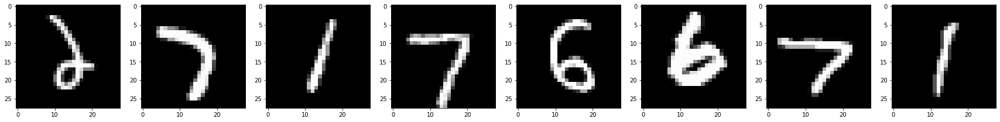

In [8]:
plt.figure(figsize=(30,20))
for i in range(1,9):
    j=random.randint(0, 42000)
    plt.subplot(1,8,i)
    grid_data = mnist_train.iloc[j,1:785].values.reshape(28,28)
    plt.imshow(grid_data, interpolation = 'none', cmap = 'gray')
plt.show()


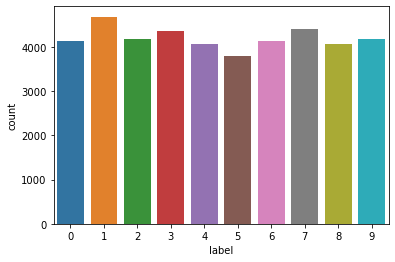

In [9]:
# count plots for the labels - training data set
sns.countplot(x = "label", data = mnist_train)

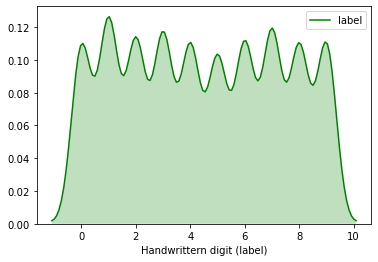

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

In [10]:
# create a kernel density plot
# KDE plot  
sns.kdeplot(mnist_train["label"], color = "green",  
            shade = True) 
plt.xlabel("Handwrittern digit (label)", fontsize=10)
plt.show() 
plt.figure() 

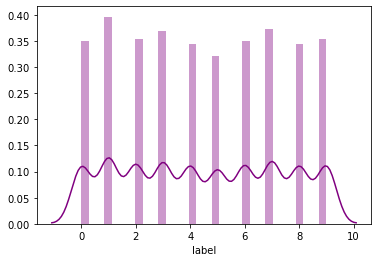

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

In [11]:
# Histogram+Density Plot  
sns.distplot(mnist_train["label"], color = "purple") 
plt.show() 
plt.figure()

In [12]:
# Prepare X_train_unscaled, y_train, and X_test_unscaled
# Note we do not have y_test
X_train_unscaled = mnist_train.iloc[:,1:785]
y_train = mnist_train['label']

X_test_unscaled = mnist_test

In [13]:
# Apply Standard Scaling on the data 
# note the pixel values range from 0 to 255 
scaler = StandardScaler()

X_train = pd.DataFrame(scaler.fit_transform(X_train_unscaled))
print ('X_train scaled data: ')
print (X_train.shape)

X_test = pd.DataFrame(scaler.transform(X_test_unscaled))
print ('X_test scaled data: ')
print (X_test.shape)

X_train scaled data: 
(42000, 784)
X_test scaled data: 
(28000, 784)



# Step 1 - Random Forest Classification using MNIST train dataset

In [14]:
# Fit a Random forest classification
start=datetime.now()
randomforestclf = RandomForestClassifier(bootstrap=True,n_estimators=10,max_features='sqrt') 
randomforestclf.fit(X_train, y_train)  
end=datetime.now()
print(end-start)

0:00:02.728446


In [15]:
# print the params of the random forest classifier model
randomforestclf.estimators_[8].get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': 'sqrt',
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'presort': 'deprecated',
 'random_state': 1775265474,
 'splitter': 'best'}

In [16]:
# Display the tree estimator with index 8 
export_graphviz(randomforestclf.estimators_[8], out_file="randomforesttree.dot",feature_names=X_train.columns,rounded=True, filled=True)

with open("randomforesttree.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

In [17]:
# Save the tree image to a png
(graph,) = pydot.graph_from_dot_file('randomforesttree.dot')
graph.write_png('randomforesttree.png')

In [18]:
print('Accuracy - Random Forest Classification Model (Training Data):', randomforestclf.score(X_train,y_train))

Accuracy - Random Forest Classification Model (Training Data): 0.9992380952380953


In [19]:
# Obtain the feature importances_
print ('Feature importances:')
indices = np.argsort(randomforestclf.feature_importances_)[::-1]
indices

Feature importances:


array([405, 568, 318, 346, 434, 486, 211, 625, 516, 210, 493, 429, 403,
       350, 489, 455, 543, 522, 514, 156, 157, 347, 456, 410, 233, 378,
       270, 348, 263, 182, 432, 437, 239, 485, 400, 539, 406, 464, 513,
       402, 183, 656, 322, 381, 430, 461, 240, 408, 375, 490, 235, 298,
       380, 521, 349, 570, 261, 376, 386, 238, 409, 542, 460, 351, 377,
       317, 267, 487, 658, 433, 427, 569, 271, 407, 657, 320, 151, 296,
       655, 515, 291, 323, 596, 242, 329, 269, 353, 125, 511, 297, 401,
       292, 326, 180, 352, 462, 299, 458, 185, 439, 488, 316, 243, 268,
       319, 379, 101, 512, 634, 438, 207, 572, 213, 373, 344, 357, 518,
       266, 624, 212, 237, 345, 654, 295, 435, 398, 324, 597, 178, 355,
       354, 321, 154, 206,  97, 293, 184, 124, 214, 300, 236, 241, 294,
       541, 150, 155, 626, 431, 262, 463, 607, 325, 459, 404, 102, 327,
       550, 153, 209, 525, 544, 603, 245, 208, 547, 315, 441, 436, 264,
       571, 328, 382,  98, 177, 659, 265, 629, 374, 399, 482, 49

Text(0, 0.5, 'importance')

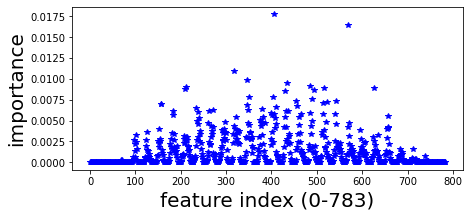

In [20]:
# Plot the feature importances
plt.figure(figsize=(7,3))
plt.plot(indices[:],randomforestclf.feature_importances_[indices[:]],'b*')
#plt.yscale("log")
plt.xlabel("feature index (0-783)",size=20)
plt.ylabel("importance",size=20)

In [21]:
# obtain the predictions for X_test using the random forest classifier 
mnist_test_pred = randomforestclf.predict(X_test)
print('MNIST test predictions: ')
mnist_test_pred

MNIST test predictions: 


array([2, 0, 9, ..., 3, 9, 2])

In [22]:
# save the results to a csv
submission_df = pd.DataFrame({'ImageId':range(1,28001),'Label':mnist_test_pred})
submission_df.to_csv('submission_rfc_mnist_test_original.csv',index=False)

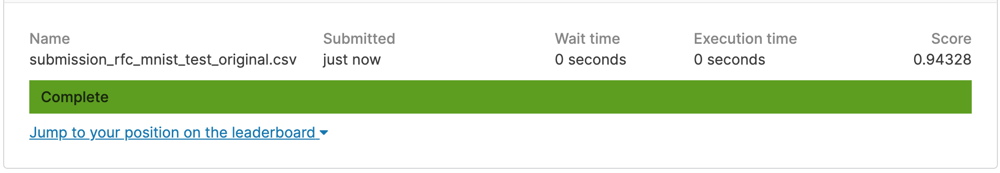

# Step 2 - Principal Component Analysis using combined MNIST training and test sets


In [23]:
# Combine mnist_train (drop the label column) and mnist_test datasets

combined_mnist_df = mnist_train.iloc[:,1:785].append(mnist_test)

print('Combined MNIST DataFrame: ')
combined_mnist_df.shape

Combined MNIST DataFrame: 


(70000, 784)

In [24]:
# Apply the standard scaler to center the mean 0 and the standard deviation to 1
scaler = StandardScaler()
combined_mnist_df = pd.DataFrame(scaler.fit_transform(combined_mnist_df))
combined_mnist_df.shape

(70000, 784)

In [25]:
combined_mnist_df

,0,1,2,3,4,5,6,7,8,9,...,774,775,776,777,778,779,780,781,782,783
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.032951,-0.023387,-0.01675,-0.010638,-0.008339,-0.005342,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.032951,-0.023387,-0.01675,-0.010638,-0.008339,-0.005342,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.032951,-0.023387,-0.01675,-0.010638,-0.008339,-0.005342,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.032951,-0.023387,-0.01675,-0.010638,-0.008339,-0.005342,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.032951,-0.023387,-0.01675,-0.010638,-0.008339,-0.005342,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69995,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.032951,-0.023387,-0.01675,-0.010638,-0.008339,-0.005342,0.0,0.0,0.0,0.0
69996,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.032951,-0.023387,-0.01675,-0.010638,-0.008339,-0.005342,0.0,0.0,0.0,0.0
69997,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.032951,-0.023387,-0.01675,-0.010638,-0.008339,-0.005342,0.0,0.0,0.0,0.0
69998,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.032951,-0.023387,-0.01675,-0.010638,-0.008339,-0.005342,0.0,0.0,0.0,0.0


In [26]:
# Fit a PCA 
start=datetime.now()
pca = PCA(n_components=0.95) ## to explain 95 percent of variance in the explanatory variables
pca.fit(combined_mnist_df)
end=datetime.now()
print(end-start)

0:00:04.093588


In [27]:
print ('PCA n_components: ')
pca.n_components_

PCA n_components: 


332

In [28]:
# create a loadings dataframe
loadings = pca.components_
num_pc = pca.n_features_
pc_list = ["PC"+str(i) for i in list(range(1, num_pc+1))]
loadings_df = pd.DataFrame.from_dict(dict(zip(pc_list, loadings)))
loadings_df['variable'] = combined_mnist_df.columns.values
loadings_df = loadings_df.set_index('variable')
loadings_df

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC323,PC324,PC325,PC326,PC327,PC328,PC329,PC330,PC331,PC332
variable,,,,,,,,,,,,,,,,,,,,,
0,-1.818558e-19,-2.381182e-19,2.191468e-19,-5.111809e-20,3.884878e-19,1.676488e-19,4.857499e-19,-5.431481e-19,2.679097e-20,-2.048152e-19,...,-1.694812e-18,-1.054417e-18,-1.840950e-18,-7.096552e-19,-1.332100e-18,6.901576e-19,-2.537368e-18,1.398807e-19,1.812505e-18,-6.895013e-19
1,-5.551115e-17,5.551115e-17,-5.551115e-17,-0.000000e+00,-1.110223e-16,9.714451e-17,5.551115e-17,-0.000000e+00,2.428613e-17,2.775558e-17,...,-1.040834e-17,1.752071e-16,3.469447e-18,-6.505213e-17,1.734723e-16,2.099015e-16,-4.510281e-17,5.421011e-17,-2.428613e-17,-9.887924e-17
2,-1.110223e-16,5.551115e-17,-5.551115e-17,-4.857226e-17,2.775558e-17,-9.020562e-17,-6.938894e-17,7.546047e-17,2.125036e-17,3.816392e-17,...,-8.673617e-17,2.428613e-17,-7.632783e-17,-8.500145e-17,1.717376e-16,9.974660e-17,1.075529e-16,-4.792174e-17,-2.081668e-17,-5.464379e-17
3,-1.110223e-16,5.551115e-17,2.775558e-17,6.938894e-18,-1.665335e-16,8.326673e-17,1.110223e-16,5.551115e-17,-5.377643e-17,0.000000e+00,...,5.204170e-17,6.938894e-18,9.714451e-17,-6.938894e-18,-4.163336e-17,-5.377643e-17,1.040834e-17,3.187554e-17,-1.110223e-16,6.418477e-17
4,-5.551115e-17,-0.000000e+00,-1.665335e-16,-4.510281e-17,1.942890e-16,1.873501e-16,-1.110223e-16,1.387779e-16,1.734723e-18,-4.163336e-17,...,4.163336e-17,4.336809e-17,9.714451e-17,5.724587e-17,9.367507e-17,-3.642919e-17,7.632783e-17,6.223320e-17,-4.163336e-17,-3.469447e-18
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
779,7.568687e-04,2.330575e-03,-7.224221e-04,1.252979e-03,3.633121e-03,1.006589e-03,5.645940e-03,9.767480e-04,3.939841e-03,-1.107021e-03,...,-2.964895e-02,4.636495e-03,4.052515e-03,-1.734866e-02,-3.202595e-02,1.854451e-03,-2.273601e-02,3.843465e-03,2.907681e-03,1.491945e-02
780,-0.000000e+00,-0.000000e+00,-0.000000e+00,-0.000000e+00,-0.000000e+00,0.000000e+00,-0.000000e+00,-0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,-0.000000e+00,-0.000000e+00,0.000000e+00,0.000000e+00,-0.000000e+00,-0.000000e+00,0.000000e+00,-0.000000e+00,0.000000e+00
781,-0.000000e+00,-0.000000e+00,-0.000000e+00,-0.000000e+00,-0.000000e+00,0.000000e+00,-0.000000e+00,-0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,-0.000000e+00,-0.000000e+00,0.000000e+00,0.000000e+00,-0.000000e+00,-0.000000e+00,0.000000e+00,-0.000000e+00,0.000000e+00


Text(0, 0.5, 'PC2 loadings')

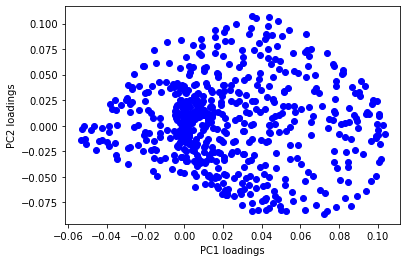

In [29]:
plt.scatter(loadings_df['PC1'], loadings_df['PC2'], marker='o', c='b')
plt.xlabel('PC1 loadings',fontsize=10)
plt.ylabel('PC2 loadings',fontsize=10)

In [30]:
print ('Explained variance ratio per each pc dimension: ')
variance = pca.explained_variance_ratio_
variance

Explained variance ratio per each pc dimension: 


array([0.05642719, 0.04041226, 0.03738273, 0.02893   , 0.02520752,
       0.02192549, 0.01914282, 0.01740684, 0.01532232, 0.01396087,
       0.01342175, 0.01201421, 0.01113962, 0.01090582, 0.01027986,
       0.00994955, 0.00931255, 0.00919635, 0.008886  , 0.00863195,
       0.00821741, 0.00798417, 0.00762573, 0.00742315, 0.0071657 ,
       0.00689314, 0.00681399, 0.00654588, 0.00627293, 0.00610345,
       0.00597261, 0.00589304, 0.00567358, 0.00559358, 0.00552473,
       0.00534443, 0.00527593, 0.00515841, 0.00505498, 0.00477438,
       0.00476312, 0.00465155, 0.00453454, 0.00445757, 0.00442313,
       0.00437877, 0.00437294, 0.00427724, 0.00424808, 0.00418524,
       0.00404059, 0.00396258, 0.00393176, 0.00390562, 0.00386444,
       0.00377501, 0.00373883, 0.00368328, 0.00360377, 0.0035637 ,
       0.00349289, 0.00344527, 0.00343239, 0.00341   , 0.00334463,
       0.00332107, 0.00329803, 0.00319433, 0.0031711 , 0.00315431,
       0.00309941, 0.00305782, 0.00305095, 0.0030396 , 0.00296

In [31]:
print ('Cumulative sum of variance explained: ')
cumsum = np.cumsum(np.round(pca.explained_variance_ratio_, decimals=4)*100)
cumsum

Cumulative sum of variance explained: 


array([ 5.64,  9.68, 13.42, 16.31, 18.83, 21.02, 22.93, 24.67, 26.2 ,
       27.6 , 28.94, 30.14, 31.25, 32.34, 33.37, 34.36, 35.29, 36.21,
       37.1 , 37.96, 38.78, 39.58, 40.34, 41.08, 41.8 , 42.49, 43.17,
       43.82, 44.45, 45.06, 45.66, 46.25, 46.82, 47.38, 47.93, 48.46,
       48.99, 49.51, 50.02, 50.5 , 50.98, 51.45, 51.9 , 52.35, 52.79,
       53.23, 53.67, 54.1 , 54.52, 54.94, 55.34, 55.74, 56.13, 56.52,
       56.91, 57.29, 57.66, 58.03, 58.39, 58.75, 59.1 , 59.44, 59.78,
       60.12, 60.45, 60.78, 61.11, 61.43, 61.75, 62.07, 62.38, 62.69,
       63.  , 63.3 , 63.6 , 63.89, 64.18, 64.47, 64.76, 65.05, 65.33,
       65.61, 65.89, 66.17, 66.45, 66.73, 67.01, 67.28, 67.55, 67.82,
       68.09, 68.35, 68.61, 68.87, 69.13, 69.39, 69.64, 69.89, 70.14,
       70.38, 70.62, 70.86, 71.1 , 71.34, 71.58, 71.81, 72.04, 72.27,
       72.49, 72.71, 72.93, 73.15, 73.37, 73.58, 73.79, 74.  , 74.21,
       74.42, 74.62, 74.82, 75.02, 75.22, 75.42, 75.61, 75.8 , 75.99,
       76.18, 76.37,

Text(0, 97, 'To explain 95% of variance, we need 332 principal components')

<Figure size 7200x2880 with 0 Axes>

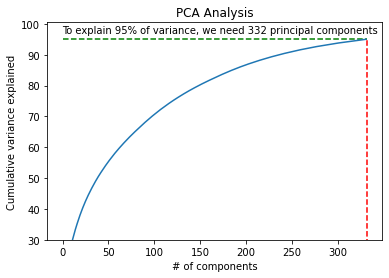

In [32]:
plt.figure(figsize=(100,40))
fig, ax = plt.subplots()
plt.ylabel('Cumulative variance explained')
plt.xlabel('# of components')
plt.title('PCA Analysis')
plt.ylim(30,100.5)
plt.style.context('seaborn-whitegrid')

plt.plot(cumsum)
plt.hlines(y=95, xmin=0.0, xmax=332,color='g',linestyles='dashed')
plt.vlines(x=332, ymin=0.0, ymax=95,color='r',linestyles='dashed')
plt.text(x=0, y=97, s="To explain 95% of variance, we need 332 principal components")

In [33]:
pca.explained_variance_

array([40.57172851, 29.05682915, 26.87856923, 20.80096479, 18.12446406,
       15.76465278, 13.76388424, 12.51569535, 11.01690489, 10.03800569,
        9.65037627,  8.63834298,  8.00950033,  7.84139416,  7.39132242,
        7.15382734,  6.69582232,  6.61226831,  6.38912392,  6.20646328,
        5.90840528,  5.74069722,  5.48297738,  5.33732321,  5.15221035,
        4.95623838,  4.89932919,  4.70655246,  4.51030375,  4.38844572,
        4.29436653,  4.23715539,  4.07936583,  4.02183857,  3.97233838,
        3.84270332,  3.79345098,  3.70895102,  3.63458298,  3.43282671,
        3.42473228,  3.34451105,  3.26038307,  3.20503935,  3.18027237,
        3.14838269,  3.14418625,  3.07537728,  3.05441235,  3.00923043,
        2.90522929,  2.84913789,  2.82697237,  2.80817775,  2.77856944,
        2.71427006,  2.68825556,  2.6483194 ,  2.59114683,  2.56233354,
        2.51142066,  2.47718739,  2.46792221,  2.45182351,  2.4048264 ,
        2.38788544,  2.37131915,  2.296757  ,  2.28005237,  2.26

In [34]:
# singular values are the square root of positive eigenvalues
# In PCA: The eigenvectors (principal components) determine the directions of the new feature space, 
# and the eigenvalues determine their magnitude.
pca.singular_values_

array([1685.22414642, 1426.16583309, 1371.66795098, 1206.66761541,
       1126.36333386, 1050.48080888,  981.55903177,  935.99474297,
        878.1641792 ,  838.24242336,  821.89822266,  777.60875141,
        748.77033449,  740.87094015,  719.29491748,  707.64451509,
        684.61731391,  680.33239609,  668.7542788 ,  659.12534693,
        643.10377187,  633.91092794,  619.51830789,  611.2342331 ,
        600.54106638,  589.0091086 ,  585.6177457 ,  573.98080576,
        561.88677895,  554.24436123,  548.27124943,  544.60686781,
        534.37021693,  530.58899194,  527.31367698,  518.63801442,
        515.30357573,  509.53200302,  504.39783319,  490.19836449,
        489.62009271,  483.85166038,  477.72748945,  473.65551764,
        471.82187895,  469.45035935,  469.13739273,  463.975575  ,
        462.39140333,  458.95873555,  450.95802999,  446.58347849,
        444.84293762,  443.36174178,  441.01823332,  435.88552411,
        433.79165631,  430.55744036,  425.88459334,  423.51007

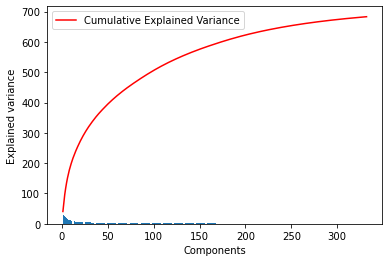

In [35]:
plt.bar(range(1,len(pca.explained_variance_ )+1),pca.explained_variance_ )
plt.ylabel('Explained variance')
plt.xlabel('Components')
plt.plot(range(1,len(pca.explained_variance_ )+1),
         np.cumsum(pca.explained_variance_),
         c='red',
         label="Cumulative Explained Variance")
plt.legend(loc='upper left')

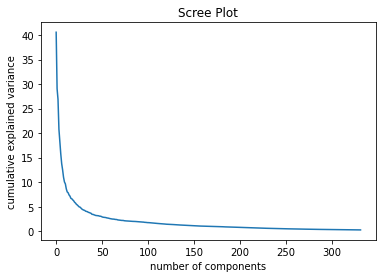

In [36]:
plt.plot(pca.explained_variance_)
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.title('Scree Plot')
plt.show()

# Step 3 - Random forest classification using PCA reduced MNIST training test

In [37]:
# Apply PCA model in Step 2 on the training (scaled) data; 
# note X_train is already scaled 
X_reduced = pd.DataFrame(pca.transform(X_train))
X_reduced.shape

(42000, 332)

In [38]:
# PCA scores for the scaled MNIST training data
X_reduced.head()

,0,1,2,3,4,5,6,7,8,9,...,322,323,324,325,326,327,328,329,330,331
0,-5.252667,-4.920823,4.170143,-0.741306,5.003335,1.896155,4.725584,-4.828216,0.225383,-1.462093,...,-0.332057,-0.201979,-0.356555,-0.136522,-0.250568,0.133137,-0.471587,0.027084,0.330624,-0.124168
1,19.313845,5.879032,1.107490,-2.224875,3.157582,-1.873040,-3.859222,0.278092,-4.046363,-4.370600,...,-0.427489,0.176039,-0.126605,-0.325829,-0.331729,-0.397762,-0.007903,0.260240,-0.685336,0.040054
2,-7.697820,-1.540537,2.362329,2.404496,4.822474,-4.308971,-0.997431,1.801566,0.330830,0.015529,...,-0.062811,-0.016545,0.236547,-0.205720,-0.151847,-0.298289,0.121984,-0.116956,-0.149203,-0.081156
3,-0.392810,5.949660,1.673197,4.324049,2.397196,2.145416,4.430821,-0.344533,0.790076,5.459375,...,0.606792,0.592984,0.494481,1.212167,0.920657,-0.520556,-1.353966,-0.466454,0.767621,0.742142
4,26.531426,5.751486,0.811820,-2.678876,9.537568,-2.643893,-6.280592,-1.586254,-4.064229,-5.828432,...,0.114824,1.243987,0.402089,1.369907,-0.159845,-0.376633,-0.348664,0.147250,-0.311304,0.242487


In [39]:
# Fit a Random Forest Classifier 
start=datetime.now()
randomforestclf_pca = RandomForestClassifier(bootstrap=True,n_estimators=10,max_features='sqrt') 
randomforestclf_pca.fit(X_reduced, y_train)  
end=datetime.now()
print(end-start)

0:00:07.390011


In [40]:
# get the params of estimator 5 in the random forest classifier
randomforestclf_pca.estimators_[5].get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': 'sqrt',
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'presort': 'deprecated',
 'random_state': 2139166040,
 'splitter': 'best'}

In [41]:
# Display the tree for estimator 5 
export_graphviz(randomforestclf_pca.estimators_[5], out_file="randomforestclf_pca.dot",feature_names=X_reduced.columns,rounded=True, filled=True)

with open("randomforestclf_pca.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

In [42]:
(graph,) = pydot.graph_from_dot_file('randomforestclf_pca.dot')
graph.write_png('randomforestclf_pca.png')

In [43]:
print('Accuracy - Random Forest Classification Model (PCA reduced training Data):', randomforestclf_pca.score(X_reduced,y_train))

Accuracy - Random Forest Classification Model (PCA reduced training Data): 0.9984761904761905


In [44]:
print ('Feature importance:')
indices = np.argsort(randomforestclf_pca.feature_importances_)[::-1]
indices

Feature importance:


array([  2,   3,   0,   5,   4,   7,   1,  12,   8,   9,  13,  15,   6,
        14,  16,  11,  10,  19,  24,  18,  22,  20,  21,  17,  25,  23,
        28,  35,  26,  34,  66,  43,  40,  42,  32,  47,  37,  29,  30,
        39,  41,  36,  27,  33,  31,  73,  83, 127,  38,  55,  46,  50,
        58,  44,  52,  65,  78,  62, 102,  45,  60,  53,  72, 112,  49,
        86,  80,  84,  85, 111,  51,  68,  57,  63,  87,  90,  69,  67,
        56, 101, 275,  61,  91,  99,  54, 124, 110, 119,  98,  81,  59,
       107, 106,  64,  70, 128,  75, 116,  77,  95, 117,  48,  71, 114,
        93, 140, 118, 115, 105,  76, 141, 113,  74, 109,  96, 197, 104,
       103, 216, 121,  82, 147, 130, 100,  94, 138, 129, 144, 123, 154,
       132, 126, 137,  89,  79,  92, 136, 125, 153, 151, 143, 120, 194,
       181, 180, 199,  88, 135, 187, 134, 176, 139, 193, 145, 108, 146,
       192, 178, 155,  97, 142, 169, 174, 164, 131, 166, 161, 162, 122,
       202, 200, 196, 171, 157, 188, 219, 150, 224, 158, 179, 14

Text(0, 0.5, 'importance')

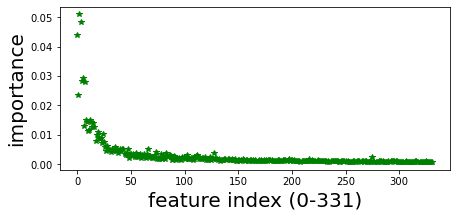

In [45]:
# Plot the feature importances
plt.figure(figsize=(7,3))
plt.plot(indices[:],randomforestclf_pca.feature_importances_[indices[:]],'g*')
#plt.yscale("log")
plt.xlabel("feature index (0-331)",size=20)
plt.ylabel("importance",size=20)

In [46]:
mnist_test_pca_pred = randomforestclf_pca.predict(pca.transform(X_test))
print('MNIST predictions on test data using PCA RF model : ')
mnist_test_pca_pred

MNIST predictions on test data using PCA RF model : 


array([2, 0, 9, ..., 3, 9, 2])

In [47]:
submission_df = pd.DataFrame({'ImageId':range(1,28001),'Label':mnist_test_pca_pred})
submission_df.to_csv('submission_pca_rfc.csv',index=False)

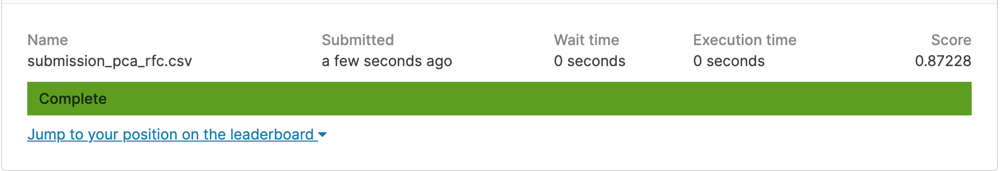

# Step 4 - Scores for RF Classifier and the PCA RF Classifier on Kaggle

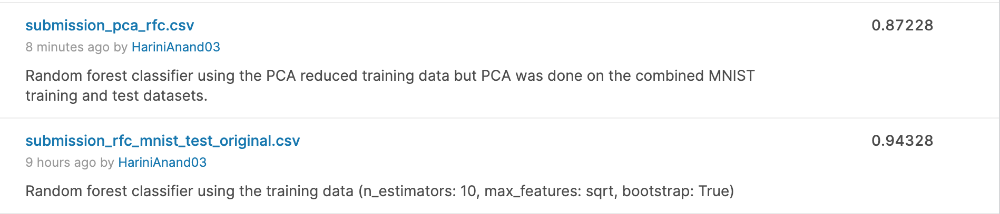

# Step 5 - Identify the flaw - We fitted the PCA to all of the combined MNIST training and test data and used the transform on the training data (PCA scores) to train the RF classifier. Doing so, we are leaking the information of test data into the PCA. 

# To fix the flaw, we will re-fit PCA to just the train data and use the transform on the training data for RF classifier fitting and separately, the transform on the test data to evaluate the RF classifier

In [48]:
start=datetime.now()
pca_correct = PCA(n_components=0.95) ## to explain 95 percent of variance in the explanatory variables
X_train_reduced = pca_correct.fit_transform(X_train) ##Note: X_train is already scaled

# Also generate the PCA transformation on the test data
X_test_reduced = pca_correct.transform(X_test)##Note: X_test is already scaled
end=datetime.now()
print(end-start)

0:00:02.170201


In [49]:
print ('PCA n_components: ')
pca_correct.n_components_

PCA n_components: 


320

In [50]:
print ('Explained variance ratio per each pc dimension: ')
variance = pca_correct.explained_variance_ratio_
variance

Explained variance ratio per each pc dimension: 


array([0.05747953, 0.04111691, 0.03782867, 0.02939862, 0.02556439,
       0.02229844, 0.01952552, 0.01771605, 0.0156266 , 0.01424956,
       0.01361009, 0.01222541, 0.01135736, 0.0111309 , 0.01050311,
       0.01012326, 0.00951303, 0.00934514, 0.00907259, 0.00885327,
       0.00838907, 0.00812027, 0.00775161, 0.00752312, 0.0072769 ,
       0.00698756, 0.00690455, 0.00664924, 0.00630675, 0.00616301,
       0.00610922, 0.00597037, 0.00577284, 0.00573682, 0.00564822,
       0.00546322, 0.0053943 , 0.00524361, 0.00504843, 0.0048853 ,
       0.00482244, 0.00475901, 0.00460008, 0.00457629, 0.00449584,
       0.00446722, 0.00443837, 0.00436837, 0.00432713, 0.00427027,
       0.00419269, 0.0041218 , 0.00402461, 0.00399434, 0.00394891,
       0.00390805, 0.00379899, 0.00372454, 0.00368413, 0.00365723,
       0.00353278, 0.00351088, 0.00345414, 0.00341394, 0.00337784,
       0.00336477, 0.0033171 , 0.00329725, 0.00320016, 0.00316776,
       0.00312695, 0.00311861, 0.00308212, 0.00303276, 0.00301

In [51]:
print ('Cumulative sum of variance explained: ')
cumsum = np.cumsum(np.round(pca_correct.explained_variance_ratio_, decimals=4)*100)
cumsum


Cumulative sum of variance explained: 


array([ 5.75,  9.86, 13.64, 16.58, 19.14, 21.37, 23.32, 25.09, 26.65,
       28.07, 29.43, 30.65, 31.79, 32.9 , 33.95, 34.96, 35.91, 36.84,
       37.75, 38.64, 39.48, 40.29, 41.07, 41.82, 42.55, 43.25, 43.94,
       44.6 , 45.23, 45.85, 46.46, 47.06, 47.64, 48.21, 48.77, 49.32,
       49.86, 50.38, 50.88, 51.37, 51.85, 52.33, 52.79, 53.25, 53.7 ,
       54.15, 54.59, 55.03, 55.46, 55.89, 56.31, 56.72, 57.12, 57.52,
       57.91, 58.3 , 58.68, 59.05, 59.42, 59.79, 60.14, 60.49, 60.84,
       61.18, 61.52, 61.86, 62.19, 62.52, 62.84, 63.16, 63.47, 63.78,
       64.09, 64.39, 64.69, 64.99, 65.28, 65.57, 65.86, 66.15, 66.43,
       66.71, 66.99, 67.27, 67.55, 67.83, 68.1 , 68.37, 68.64, 68.91,
       69.17, 69.43, 69.69, 69.94, 70.19, 70.44, 70.69, 70.94, 71.18,
       71.42, 71.66, 71.9 , 72.13, 72.36, 72.59, 72.82, 73.04, 73.26,
       73.48, 73.7 , 73.92, 74.13, 74.34, 74.55, 74.75, 74.95, 75.15,
       75.35, 75.55, 75.75, 75.94, 76.13, 76.32, 76.51, 76.7 , 76.89,
       77.07, 77.25,

Text(0, 97, 'To explain 95% of variance, we need 320 principal components')

<Figure size 7200x2880 with 0 Axes>

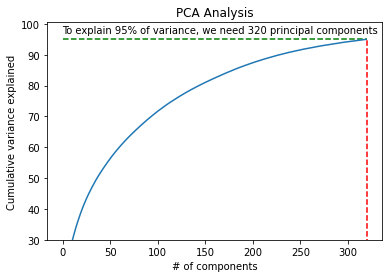

In [52]:
plt.figure(figsize=(100,40))
fig, ax = plt.subplots()
plt.ylabel('Cumulative variance explained')
plt.xlabel('# of components')
plt.title('PCA Analysis')
plt.ylim(30,100.5)
plt.style.context('seaborn-whitegrid')

plt.plot(cumsum)
plt.hlines(y=95, xmin=0.0, xmax=320,color='g',linestyles='dashed')
plt.vlines(x=320, ymin=0.0, ymax=95,color='r',linestyles='dashed')
plt.text(x=0, y=97, s="To explain 95% of variance, we need 320 principal components")

In [53]:
pca_correct.explained_variance_

array([40.69647875, 29.11146566, 26.7833371 , 20.81471943, 18.10002059,
       15.78767373, 13.82440068, 12.54326427, 11.06389745, 10.08892666,
        9.63617203,  8.6557947 ,  8.04120472,  7.88086691,  7.4363756 ,
        7.16743699,  6.73538375,  6.61651973,  6.42354578,  6.26826675,
        5.93960379,  5.74928832,  5.4882688 ,  5.32649477,  5.15217038,
        4.94730998,  4.88853571,  4.70777145,  4.46528559,  4.36351702,
        4.3254315 ,  4.22712324,  4.08726514,  4.06176768,  3.99903435,
        3.86804997,  3.81925839,  3.71256507,  3.57437538,  3.45887625,
        3.41436841,  3.36945857,  3.25693182,  3.24008824,  3.18312949,
        3.1628664 ,  3.14244041,  3.09287815,  3.06368054,  3.02342271,
        2.96849737,  2.91830693,  2.84948896,  2.82806029,  2.79589667,
        2.76696531,  2.68974637,  2.63703541,  2.60842615,  2.58938021,
        2.50126884,  2.48576071,  2.44558621,  2.41712754,  2.39156842,
        2.38231165,  2.34856157,  2.3345102 ,  2.26576633,  2.24

In [54]:
# singular values are the square root of positive eigenvalues
# In PCA: The eigenvectors (principal components) determine the directions of the new feature space, 
# and the eigenvalues determine their magnitude.
pca_correct.singular_values_

array([1307.36812368, 1105.73615575, 1060.60047841,  934.98524113,
        871.88460515,  814.28895924,  761.97834875,  725.813031  ,
        681.66900266,  650.9414958 ,  636.16789363,  602.93840611,
        581.13901694,  575.31602546,  558.85627738,  548.65762193,
        531.86406375,  527.1500852 ,  519.40590997,  513.08959753,
        499.45712485,  491.39023209,  480.10603124,  472.97722319,
        465.17309017,  455.831188  ,  453.11545035,  444.65907508,
        433.05603483,  428.09269006,  426.22036265,  421.34896334,
        414.31998316,  413.02564173,  409.82367371,  403.05611362,
        400.50597154,  394.8721571 ,  387.45347007,  381.14215667,
        378.68200229,  376.18332036,  369.84845495,  368.89085893,
        365.63404554,  364.46841531,  363.28962951,  360.41335901,
        358.70812487,  356.34355674,  353.09194432,  350.09423408,
        345.94173911,  344.63851206,  342.67311546,  340.89554995,
        336.10512895,  332.79550776,  330.98533169,  329.77474

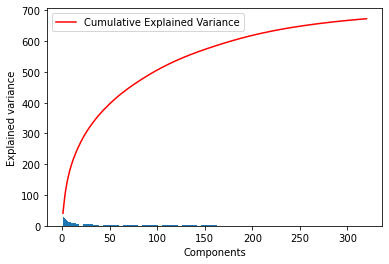

In [55]:
plt.bar(range(1,len(pca_correct.explained_variance_ )+1),pca_correct.explained_variance_ )
plt.ylabel('Explained variance')
plt.xlabel('Components')
plt.plot(range(1,len(pca_correct.explained_variance_ )+1),
         np.cumsum(pca_correct.explained_variance_),
         c='red',
         label="Cumulative Explained Variance")
plt.legend(loc='upper left')

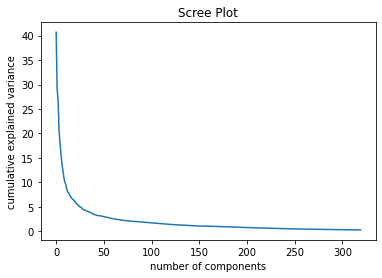

In [56]:
plt.plot(pca_correct.explained_variance_)
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.title('Scree Plot')
plt.show()

Text(0.5, 1.0, 'Loadings plot with revised PCA design')

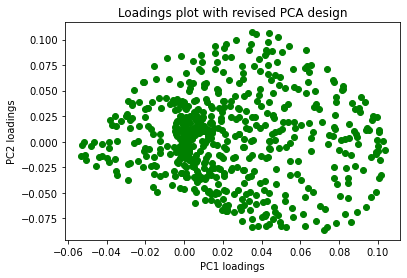

In [57]:
plt.scatter(loadings_df['PC1'], loadings_df['PC2'], marker='o', c='g')
plt.xlabel('PC1 loadings',fontsize=10)
plt.ylabel('PC2 loadings',fontsize=10)
plt.title('Loadings plot with revised PCA design')

## Fit a Random Forest Classifier just on the PCA reduced train data

In [58]:
start=datetime.now()
rfc_pca_correct = RandomForestClassifier(bootstrap=True,n_estimators=10,max_features='sqrt')
rfc_pca_correct.fit(X_train_reduced, y_train)
end=datetime.now()
print(end-start)

0:00:07.215956


In [59]:
rfc_pca_correct.estimators_[5].get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': 'sqrt',
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'presort': 'deprecated',
 'random_state': 1062048758,
 'splitter': 'best'}

In [60]:
col_names = pd.DataFrame(X_train_reduced).columns
export_graphviz(rfc_pca_correct.estimators_[5], out_file="randomforestclf_pca_correct.dot",feature_names=col_names,rounded=True, filled=True)

with open("randomforestclf_pca_correct.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

In [61]:
(graph,) = pydot.graph_from_dot_file('randomforestclf_pca_correct.dot')
graph.write_png('randomforestclf_pca_correct.png')

In [62]:
print('Accuracy - Random Forest Classification Model (corrected PCA reduced training Data):', rfc_pca_correct.score(X_train_reduced,y_train))

Accuracy - Random Forest Classification Model (corrected PCA reduced training Data): 0.9989523809523809


In [63]:
print ('Feature importance:')
indices = np.argsort(rfc_pca_correct.feature_importances_)[::-1]
indices

Feature importance:


array([  3,   2,   0,   4,   5,   7,   1,  12,  15,   9,  14,  16,   8,
        11,  19,  22,  13,   6,  10,  21,  25,  24,  23,  18,  17,  20,
        27,  37,  31,  34,  33,  35,  26,  43,  42,  28,  32,  54,  30,
        29,  40,  36,  47,  38,  61,  62,  51,  78,  39,  41,  56,  86,
        46,  60,  49,  53,  45,  75,  52,  73, 107,  94,  65,  95,  50,
        63,  76,  68,  57,  82,  58,  84,  79,  44,  83, 104, 227,  64,
       102,  98,  72, 105,  59,  55,  90,  71,  81, 101,  85,  70, 119,
        67,  69, 111, 166,  97,  48, 106, 129, 136, 100, 103,  66, 126,
        74,  96,  80, 120,  77,  91,  92, 122,  87, 117, 115,  89, 114,
       118, 110, 131,  88, 109, 112, 113, 160, 179, 157, 133, 145, 125,
       128, 139, 108, 130, 123, 121, 140, 137, 116, 150,  99, 127, 178,
       144, 152, 147, 153, 159, 134, 156, 182, 202, 158, 149, 165, 177,
       181, 192, 175, 135, 138, 174, 170, 164, 143, 155, 124, 244, 132,
       173, 146, 205, 245,  93, 142, 184, 151, 172, 190, 189, 21

Text(0, 0.5, 'importance')

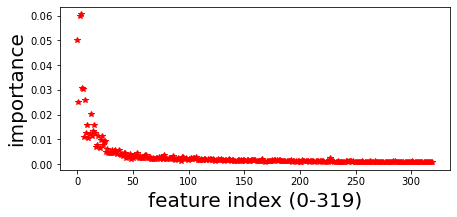

In [64]:
# Plot the feature importances
plt.figure(figsize=(7,3))
plt.plot(indices[:],rfc_pca_correct.feature_importances_[indices[:]],'r*')
#plt.yscale("log")
plt.xlabel("feature index (0-319)",size=20)
plt.ylabel("importance",size=20)


In [65]:
mnist_test_pca_correct_pred = rfc_pca_correct.predict(X_test_reduced)
print('MNIST predictions on test data using correct PCA RF model : ')
mnist_test_pca_correct_pred

MNIST predictions on test data using correct PCA RF model : 


array([2, 0, 4, ..., 3, 9, 2])

In [66]:
submission_df = pd.DataFrame({'ImageId':range(1,28001),'Label':mnist_test_pca_correct_pred})
submission_df.to_csv('submission_pca_rfc_correct.csv',index=False)

#  K-means clustering to group MNIST observations into 1 of 10 categories and then assign labels

## Version 1 - plain K-Means

In [67]:
# Fit a K-Means clustering to the scaled trained data 
# Note: We scaled MNIST training data at the start and saved it to X_train
# number of clusters = number of digits in the data 
start=datetime.now()
n_clusters = len(np.unique(y_train))
kmeansv1 = KMeans(n_clusters = n_clusters, init='k-means++',max_iter=400, n_init=20, random_state=RANDOM_SEED)
kmeansv1.fit(X_train)
end=datetime.now()
print(end-start)

0:00:33.493449


In [68]:
# obtain the labels provided by K-Means clustering for training data and test data 
y_labels_train = kmeansv1.labels_
y_labels_test = kmeansv1.predict(X_test)

In [69]:
y_labels_train

array([2, 5, 2, ..., 7, 0, 8], dtype=int32)

In [70]:
y_labels_test

array([1, 5, 2, ..., 9, 8, 1], dtype=int32)

In [71]:
# labels predicted using K-Means for the first 8 digits
y_labels_test[0:8]

array([1, 5, 2, 7, 9, 7, 5, 9], dtype=int32)

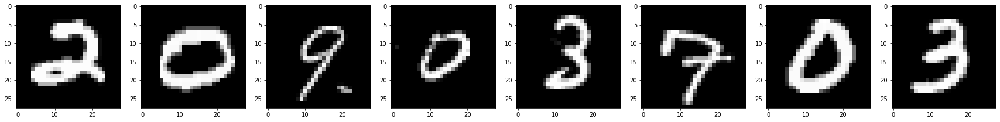

In [72]:
# print the first 8 digits
plt.figure(figsize=(30,20))
for i in range(0,8):
    plt.subplot(1,8,(i+1))
    grid_data = mnist_test.iloc[i].values.reshape(28,28)
    plt.imshow(grid_data, interpolation = 'none', cmap = 'gray')
plt.show()

In [73]:
# save the labels for the test dataset generated by K-Means
submission_df = pd.DataFrame({'ImageId':range(1,28001),'Label':y_labels_test})
submission_df.to_csv('submission_k_means_version1.csv',index=False)

In [74]:
print ('Score for K-Means clustering with K-Means++ initialization (on training data): ')
kmeansv1.score(X_train)

Score for K-Means clustering with K-Means++ initialization (on training data): 


-25069443.167928014

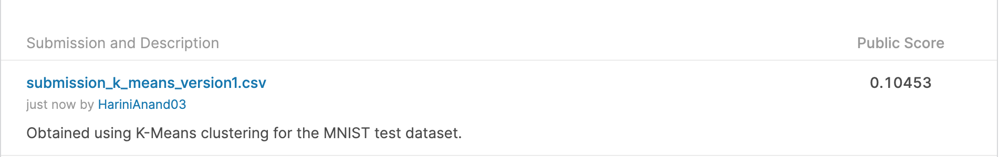

## Version 2 - based on the code shared in KMeans_MNIST.pdf

In [75]:
# store the explanatory variables as an array into X 
# store the digit label in Y
X = mnist_train.iloc[:,1:785].values.reshape(len(X_train),-1)
Y = mnist_train.iloc[:,0]

In [76]:
# normalize the data to 0 - 1
# we do not use standard scaling here
X = X.astype(float) / 255.

print(X.shape)
print(X[0].shape)

(42000, 784)
(784,)


In [77]:
# Initialize and fit KMeans algorithm
start=datetime.now()
kmeans = MiniBatchKMeans(n_clusters = len(np.unique(Y)))
kmeans.fit(X)
end=datetime.now()
print(end-start)

0:00:00.661062


In [78]:
# record centroid values
centroids = kmeans.cluster_centers_

In [79]:
# reshape centroids into images
images = centroids.reshape(10, 28, 28)
images *= 255
images = images.astype(np.uint8)

In [80]:
def infer_cluster_labels(kmeans, actual_labels):
    inferred_labels = {}
    for i in range(kmeans.n_clusters):
        # find index of points in cluster
        labels = []
        index = np.where(kmeans.labels_ == i)

        # append actual labels for each point in cluster
        labels.append(actual_labels.iloc[index])
        
        # determine most common label
        if len(labels[0]) == 1:
            counts = np.bincount(labels[0])
        else:
            counts = np.bincount(np.squeeze(labels))
            
        # assign the cluster to a value in the inferred_labels dictionary
        if np.argmax(counts) in inferred_labels:
            # append the new number to the existing array at this slot
            inferred_labels[np.argmax(counts)].append(i)
        else:
            # create a new array in this slot
            inferred_labels[np.argmax(counts)] = [i]
        #print(labels)
        #print('Cluster: {}, label: {}'.format(i, np.argmax(counts)))
    print(inferred_labels)
    return inferred_labels

def infer_data_labels(X_labels, cluster_labels):
    # empty array of len(X)
    predicted_labels = np.zeros(len(X_labels)).astype(np.uint8)
    for i, cluster in enumerate(X_labels):
        for key, value in cluster_labels.items():
            if cluster in value:
                predicted_labels[i] = key
    return predicted_labels



{1: [0], 4: [1], 7: [2], 0: [3, 8], 3: [4, 7], 6: [5], 9: [6], 2: [9]}


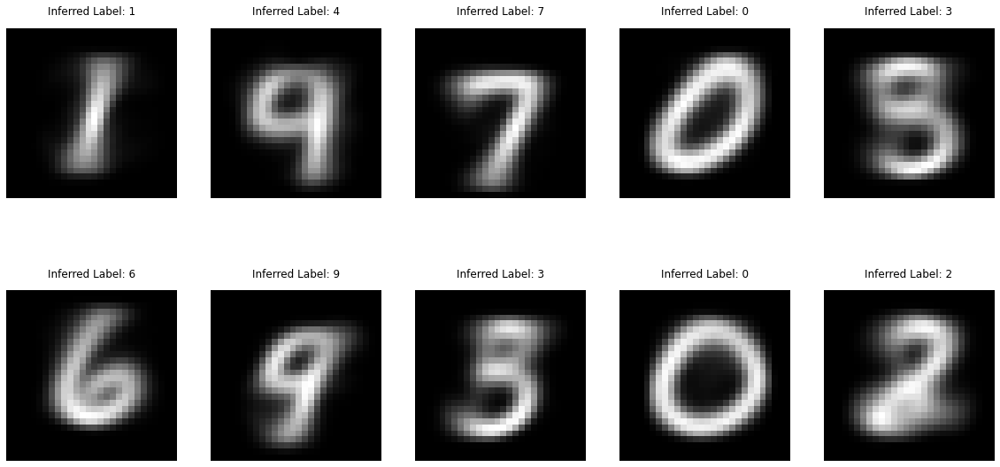

In [81]:
# determine cluster labels
cluster_labels = infer_cluster_labels(kmeans, Y)

# create figure with subplots using matplotlib.pyplot
fig, axs = plt.subplots(2, 5, figsize = (20, 10))
plt.gray()

# loop through subplots and add centroid images
for i, ax in enumerate(axs.flat):
    # determine inferred label using cluster_labels dictionary
    for key, value in cluster_labels.items():
        if i in value:
            ax.set_title('Inferred Label: {}'.format(key))
    # add image to subplot
    grid_data = images[i].reshape(28,28)
    #ax.imshow(grid_data, interpolation = 'none',cmap = 'gray')
    ax.matshow(grid_data)
    ax.axis('off')

# display the figure
plt.show()

In [82]:
def calculate_metrics(estimator, data, labels):

    # Calculate and print metrics
    print('Number of Clusters: {}'.format(estimator.n_clusters))
    print('Inertia: {}'.format(estimator.inertia_))
    print('Homogeneity: {}'.format(metrics.homogeneity_score(labels, estimator.labels_)))
 

In [83]:
calculate_metrics(kmeans, X, Y)

Number of Clusters: 10
Inertia: 1666729.3966799686
Homogeneity: 0.4969173370248951


In [87]:
X_test = mnist_test

# test kmeans algorithm on testing dataset
# convert each image to 1 dimensional array
X_test = X_test.values.reshape(len(X_test),-1)

# normalize the data to 0 - 1
X_test = X_test.astype(float) / 255.

# predict labels for testing data
test_clusters = kmeans.predict(X_test)
predicted_labels = infer_data_labels(kmeans.predict(X_test), cluster_labels)

In [89]:
test_clusters

array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

In [90]:
# save the labels for the test dataset generated by K-Means
submission_df = pd.DataFrame({'ImageId':range(1,28001),'Label':predicted_labels})
submission_df.to_csv('submission_minibatchkmeans.csv',index=False)

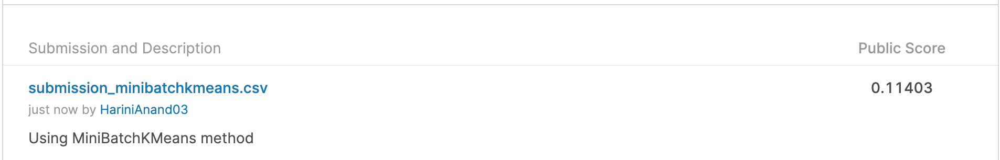